# TensorFlow - Protect the Great Barrier Reef - Competition Objective

# [Link to my Youtube Video Explaining this whole Notebook](https://youtu.be/CqnvNgr5050)

[![Imgur](https://imgur.com/A4qcuSM.png)](https://youtu.be/YLzhTG1ILaY)


Competition Goal: accurately identify starfish (COTS - coral-eating Crown-Of-Thorns Starfish) in real-time by building an object detection model trained on underwater videos of coral reefs. This way we can help researchers & scientists to control COTS outbreaks, which are a threat to the Great Barrier Reef.

A COTS outbreak can have devastating impacts to an entire coral reef, and depending on the event the ravenous starfish could wipe out nearly all living corals.

# Data Structuring and knowing the data

## [train.csv]

The `train.csv` dataset contains 5 columns that help identify the position within the video and sequence of the .jpg images within the `train_images` folder.

Additionaly, it has an `annotations` columns, which can be empty (`[]`) or could contain 1 or multiple coordinates for the location (or a bounding box) of the COTS.

![](https://i.imgur.com/xSuUaxf.png)

So the Video-ID can numbers between 0, 1 and 2, and the Training Images are also segregated accordingly, i.e. I have 3 Folders named video_0, video_1 and video_2


**video_id** - ID number of the video the image was part of. The video ids are not meaningfully ordered.

**video_frame** - The frame number of the image within the video. Expect to see occasional gaps in the frame number from when the diver surfaced.¶

**sequence** - ID of a gap-free subset of a given video. The sequence ids are not meaningfully ordered.

**sequence_frame** - The frame number within a given sequence.

**image_id** - ID code for the image, in the format '{video_id}-{video_frame}'

**annotations** - The bounding boxes of any starfish detections in a string format that can be evaluated directly with Python. Does not use the same format as the predictions you will submit. Not available in test.csv. A bounding box is described by the pixel coordinate (x_min, y_min) of its upper left corner within the image together with its width and height in pixels.

**example_sample_submission.csv** - A sample submission file in the correct format. The actual sample submission will be provided by the API; this is only provided to illustrate how to properly format predictions. The submission format is further described on the Evaluation page.

**example_test.npy** - Sample data that will be served by the example API.


---


Data augmentation is a commonly used technique for increasing both the size and the diversity of labeled training sets by leveraging input transformations that preserve corresponding output labels. In computer vision, image augmentations have become a common implicit regularization technique to combat overfitting in deep learning models and are ubiquitously used to improve performance

In [1]:
# from google.colab import drive # Uncomment in Colab
# drive.mount('/content/drive') # Uncomment in Colab

# # In Google Colab I had to re-install following version of 
# # opencv-python-headless to be compatible in Colab environment
# # https://stackoverflow.com/a/70538761/1902852 
# !pip uninstall opencv-python-headless  # Uncomment in Colab
# !pip install opencv-python-headless==4.5.2.52 # Uncomment in Colab

In [ ]:
# In Google Colab I had to re-install albumentations
# to be compatible in Colab environment
# !pip install --upgrade --force-reinstall --no-deps albumentations # Uncomment in Colab
# !pip install qudida # Uncomment in Colab

import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns
sns.set_style('darkgrid')

from PIL import Image, ImageDraw
import tensorflow as tf

import os
import ast  ## Change str -> list.


import albumentations as A

import warnings
warnings.filterwarnings("ignore")

import os
import cv2 
import pandas as pd
import numpy as np

import ast
import sys

from tqdm.notebook import tqdm
tqdm.pandas()

from PIL import Image
from IPython.display import display

In [3]:
# Root dir in Colab and Data in G-Drive
# ROOT_DIR  = '/content/drive/MyDrive/All_Datasets/TF-Great-Barrier-Reef-Jan-31-22/'

# Root Dir in Local Machine
ROOT_DIR  = '../input/tensorflow-great-barrier-reef/'

# Root Dir in Kaggle
# ROOT_DIR  = '/kaggle/input/tensorflow-great-barrier-reef/'

df = pd.read_csv(ROOT_DIR + "train.csv")
df.head()

,video_id,sequence,video_frame,sequence_frame,image_id,annotations
0,0,40258,0,0,0-0,[]
1,0,40258,1,1,0-1,[]
2,0,40258,2,2,0-2,[]
3,0,40258,3,3,0-3,[]
4,0,40258,4,4,0-4,[]


In [4]:
df_train = pd.read_csv(ROOT_DIR + "train.csv")

# Create a new column named path_of_image in the above dataframe
df_train['path_of_img'] = os.path.join(ROOT_DIR+ 'train_images')+'/video_'+ df_train.video_id.astype(str)+'/'+ df_train.video_frame.astype(str) + '.jpg'

df_train.head()

,video_id,sequence,video_frame,sequence_frame,image_id,annotations,path_of_img
0,0,40258,0,0,0-0,[],../input/tensorflow-great-barrier-reef/train_i...
1,0,40258,1,1,0-1,[],../input/tensorflow-great-barrier-reef/train_i...
2,0,40258,2,2,0-2,[],../input/tensorflow-great-barrier-reef/train_i...
3,0,40258,3,3,0-3,[],../input/tensorflow-great-barrier-reef/train_i...
4,0,40258,4,4,0-4,[],../input/tensorflow-great-barrier-reef/train_i...


In [5]:
df_train['path_of_img'][0]

'../input/tensorflow-great-barrier-reef/train_images/video_0/0.jpg'

# Exploratory Data Analysis

Let's count how many images are there from each of the three videos.


<AxesSubplot:xlabel='video_id', ylabel='count'>

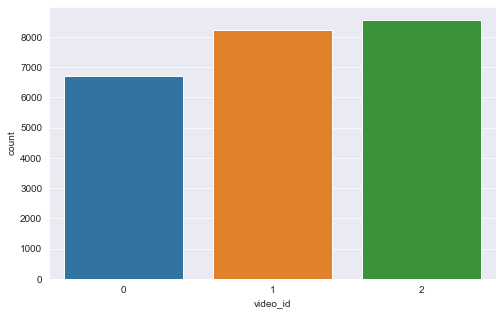

In [6]:
plt.figure(figsize=(8,5))

sns.countplot(df_train['video_id'])

To check if the Data is Balanced or Imbalanced - calculate how many images are with bounding boxes and how many are without.

In [7]:
with_annotation = len(df_train[df_train['annotations'] != '[]'])
without_annotation = len(df_train[df_train['annotations'] == '[]'])

labels = ['Without Bounding Box', 'With Bounding Box']

fig = go.Figure([go.Bar(x=labels, 
                        y=[without_annotation, with_annotation], width=0.6)])

fig.update_layout(autosize=False, width=700, height=400, margin=dict(l=60, r=60, b=50, t=50, pad=4))
fig.show()

### Now for selecting an image to apply all augmentations from albumentations package I need to find images which has quite a few "bounding boxes" in the annotations column. Basically these images have many starfish in it.

So lets first create a df for all images with more than 5 annotations.

For that, first lets find out how many bounding boxes are there in each annotation columns.

I can simply count the number of closing curly brackets - '}' in annotation column.

E.g. looking at train.csv - For video_frame no 36 I have below in the annotations column

`[{'x': 520, 'y': 148, 'width': 80, 'height': 63}, {'x': 598, 'y': 206, 'width': 61, 'height': 34}]`

Meaning it has 2 bounding boxes.

In [8]:
df_train['num_of_bboxes'] = df_train['annotations'].apply(lambda x: x.count('}'))

df_train.head()
df_train['annotations'][36]

"[{'x': 520, 'y': 148, 'width': 80, 'height': 63}, {'x': 598, 'y': 206, 'width': 61, 'height': 34}]"

In [9]:
bbox_count_fig = px.bar(df_train['num_of_bboxes'].value_counts().drop(0), title='Plot of Num of Bboxes')
bbox_count_fig.update_layout(autosize=False, width = 700, height=500, margin=dict(l=45, b=45, t=45, pad=3))
bbox_count_fig.show()

Max number of images has only single Bounding Box. Very few have more than 5 BBox.

So now to build my df based on Number of Bounding Boxes, first change 'annotations' from string to list data type using ast.

In [10]:
df_train['annotations'] = df_train['annotations'].apply(ast.literal_eval)

# df_train['annotations'] = df_train['annotations'].apply(ast.literal_eval)

# df_train['annotations'] = df_train['annotations'].progress_apply(lambda x: ast.literal_eval(x))

# def get_bbox(annots):
#     bboxes = [list(annot.values()) for annot in annots]
#     return bboxes

# df_train['bboxes'] = df_train.annotations.progress_apply(get_bbox)

df_train.head()

,video_id,sequence,video_frame,sequence_frame,image_id,annotations,path_of_img,num_of_bboxes
0,0,40258,0,0,0-0,[],../input/tensorflow-great-barrier-reef/train_i...,0
1,0,40258,1,1,0-1,[],../input/tensorflow-great-barrier-reef/train_i...,0
2,0,40258,2,2,0-2,[],../input/tensorflow-great-barrier-reef/train_i...,0
3,0,40258,3,3,0-3,[],../input/tensorflow-great-barrier-reef/train_i...,0
4,0,40258,4,4,0-4,[],../input/tensorflow-great-barrier-reef/train_i...,0


Creating new DataFrame which carry images containing 4 Bounding Boxes and then use that row's 'video_id' to see image with Bounding Boxes.

In [11]:
df_train_bbox_4 = df_train[df_train['annotations'].astype(str) != "[]"]
df_train_bbox_4 = df_train_bbox_4[df_train_bbox_4['num_of_bboxes'] == 4]
df_train_bbox_4.head()


,video_id,sequence,video_frame,sequence_frame,image_id,annotations,path_of_img,num_of_bboxes
2635,0,8399,4558,820,0-4558,"[{'x': 186, 'y': 67, 'width': 50, 'height': 43...",../input/tensorflow-great-barrier-reef/train_i...,4
2636,0,8399,4559,821,0-4559,"[{'x': 185, 'y': 71, 'width': 50, 'height': 43...",../input/tensorflow-great-barrier-reef/train_i...,4
2637,0,8399,4560,822,0-4560,"[{'x': 185, 'y': 74, 'width': 50, 'height': 43...",../input/tensorflow-great-barrier-reef/train_i...,4
2638,0,8399,4561,823,0-4561,"[{'x': 184, 'y': 78, 'width': 50, 'height': 43...",../input/tensorflow-great-barrier-reef/train_i...,4
2639,0,8399,4562,824,0-4562,"[{'x': 182, 'y': 80, 'width': 50, 'height': 43...",../input/tensorflow-great-barrier-reef/train_i...,4


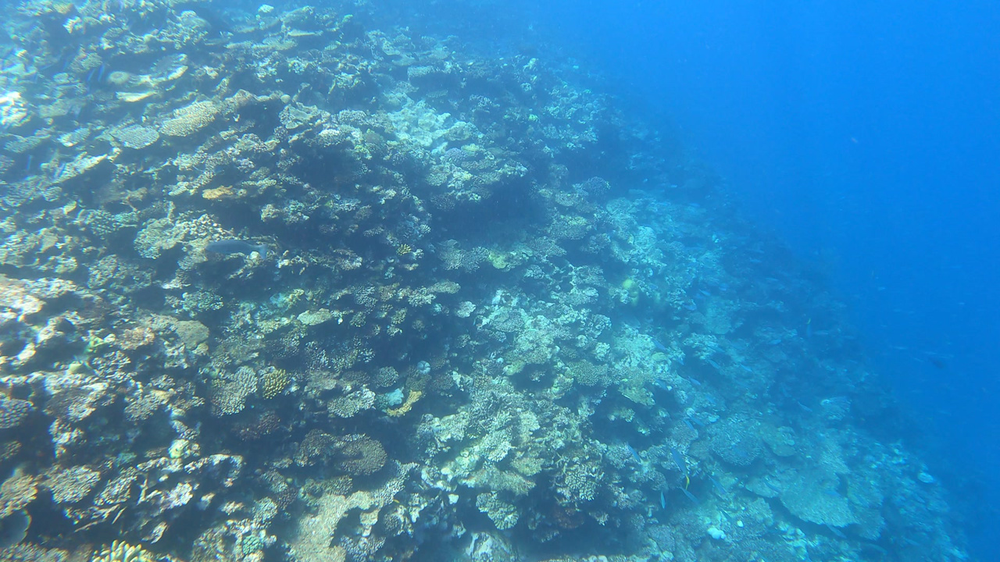

In [12]:
img_selected = df_train_bbox_4['path_of_img'][2635]
img_selected_display = Image.open(img_selected)
display(img_selected_display)

### draw Bounding Boxes with ImageDraw.Draw

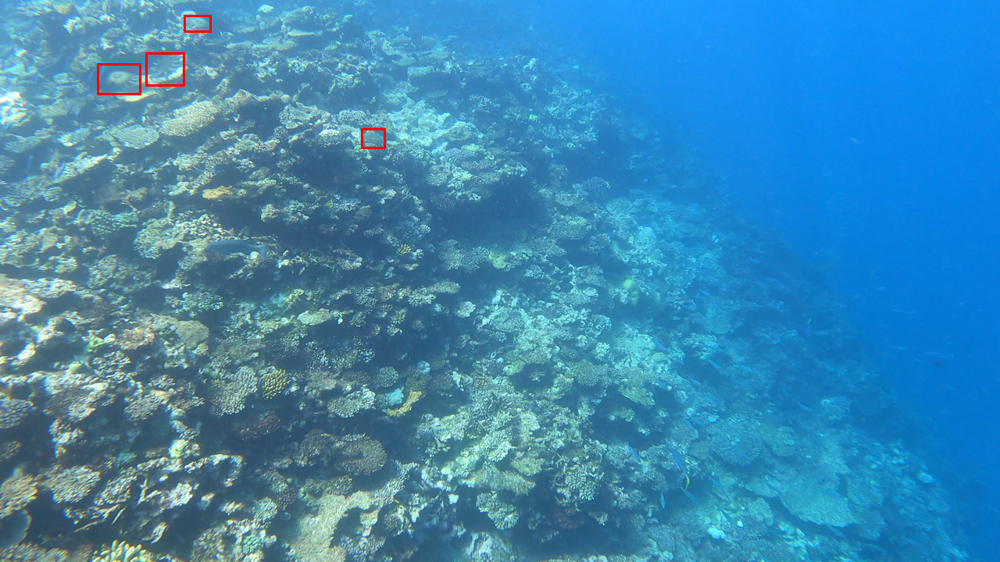

In [13]:
def get_img_with_rectangle(img, id):    
    for box in df_train['annotations'][id]:
        # Four points to define the bounding box. Sequence of either 
        # [(x0, y0), (x1, y1)] or [x0, y0, x1, y1]. 
        # The second point is just outside the drawn rectangle.
        shape = [box['x'], box['y'], box['x']+box['width'], box['y']+box['height']]
        ImageDraw.Draw(img).rectangle(shape, outline ="red", width=3)
    return img

random_img_path  = df_train['path_of_img'][2635]
random_img = Image.open(random_img_path)
get_img_with_rectangle(random_img, id=2635)

In [14]:
def get_augmented_img(img, augmentation_method):
    """
        img: a numpy array of the image
        augmentation: Any of the Official Augmentation methods
        https://albumentations.ai/docs/getting_started/transforms_and_targets/
        
        returns: The augmented image as a numpy array. 
        So to get the image, we will need to use the Image.fromarray() method.
    """
    transform = A.Compose([augmentation_method])
    augmented_img = transform(image=img)['image']
    return(augmented_img)

In [15]:
img_selected = df_train_bbox_4['path_of_img'][2635]
img_selected_display = Image.open(img_selected)

Note for most Methods - The parameter "p" is probability of applying the transform. Default: 0.5.



## Blur

Why Blurring is sometime needed 

Blur can be applied as a preprocessing technique or image augmentation technique. If all images in production may have blur involved, all images in training, validation, and testing should be blurred in preprocessing. More commonly, however, only some images may have blur.

Consider:

* A camera is stationary, but objects it is detecting are often moving; e.g. a camera is watching traffic
* A camera is moving, but objects it is detecting are stationary; e.g. a user has a mobile app to scan a book cover
* A camera and its objects its detecting are moving; e.g. a drone is flying over a windy field of crops to detect

In each of these examples, blur is a useful augmentation step. That is, some of our images are varied in random amounts to simulate different amounts of blur.

Now for 

albumentations.augmentations.transforms.Blur : Blur the input image using a random-sized kernel.

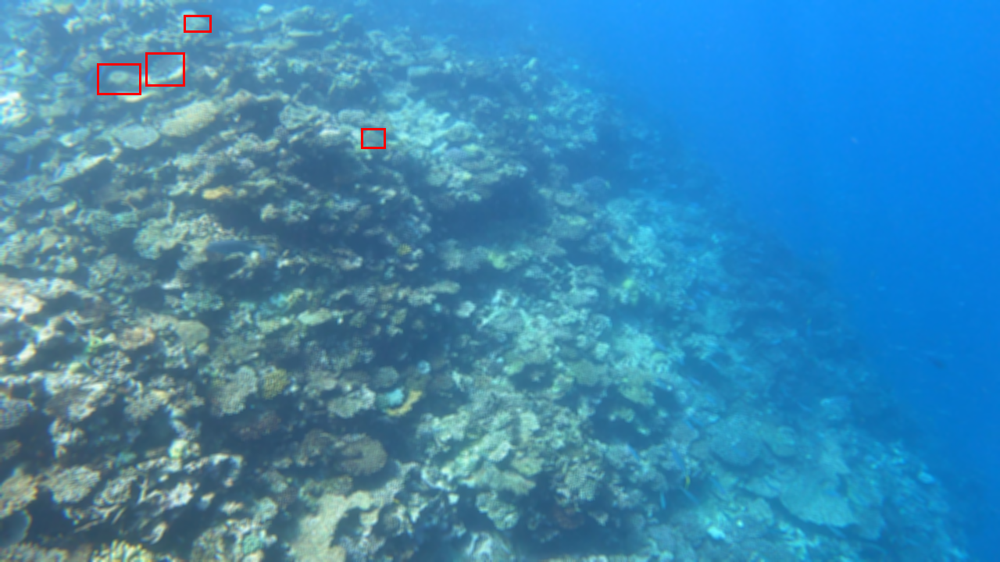

In [16]:
AUGMENTATION = A.Blur(p = 1.0)
# p is probability of applying the transform. Default: 0.5.

np_img = np.array(img_selected_display)

def aug_blur(img):
  img_aug = get_augmented_img(img, AUGMENTATION)    
  img_aug = Image.fromarray(img_aug)
  # fromarray creates an image memory from an object exporting the array interface
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
aug_blur(np_img)  

## Applying MedianBlur

Traditionally, the median blur method has been most effective when removing salt-and-pepper noise. This type of noise is exactly what it sounds like: imagine taking a photograph, putting it on your dining room table, and sprinkling salt and pepper on top of it. Using the median blur method, you could remove the salt and pepper from your image.

Again, methods such as averaging and Gaussian compute means or weighted means for the neighborhood — this average pixel intensity may or may not be present in the neighborhood. But by definition, the median pixel must exist in our neighborhood. By replacing our central pixel with a median rather than an average, we can substantially reduce noise.

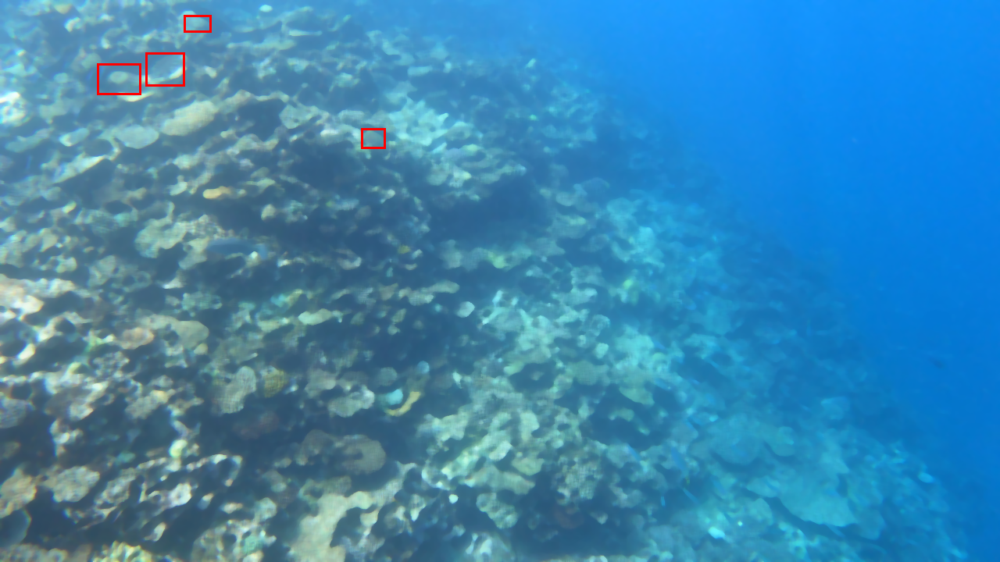

In [17]:
AUGMENTATION = A.MedianBlur(p= 1.0)

def aug_medianblur(img):
  img_aug = get_augmented_img(img, AUGMENTATION)
  img_aug = Image.fromarray(img_aug)
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
np_img = np.array(img_selected_display)
aug_medianblur(np_img)
  

### GaussianBlur

Gaussian blurring uses weighted mean, where neighborhood pixels that are closer to the central pixel contribute more “weight” to the average.

And as the name suggests, Gaussian smoothing is used to remove noise that approximately follows a Gaussian distribution.

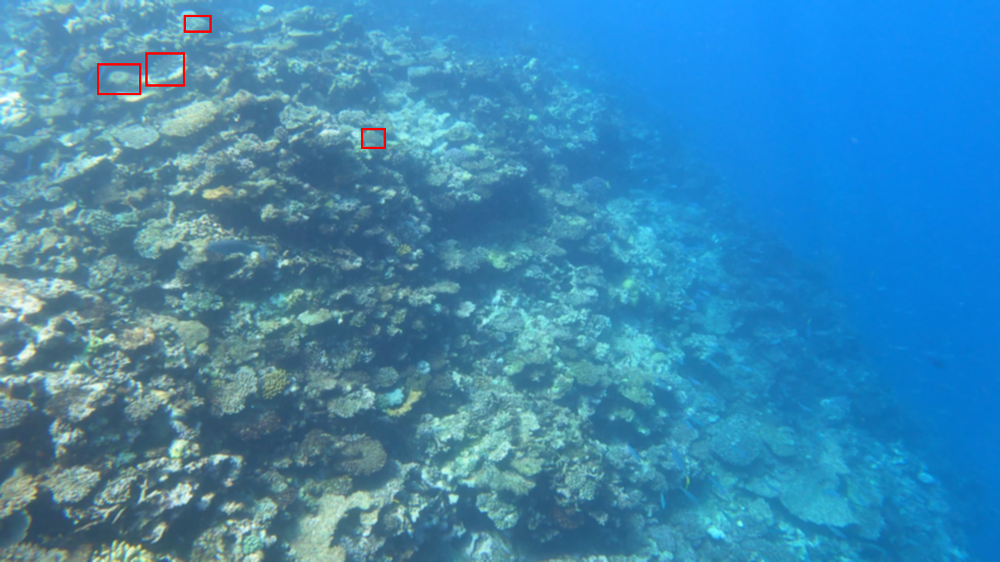

In [35]:
AUGMENTATION = A.GaussianBlur(p= 1.0)

def aug_medianblur(img):
  img_aug = get_augmented_img(img, AUGMENTATION)
  img_aug = Image.fromarray(img_aug)
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
np_img = np.array(img_selected_display)

for i in range(1):
  aug_medianblur(np_img)
  

## Downscale

Decreases image quality by downscaling and upscaling back.

scale_min:	float	and is the lower bound on the image scale. Should be < 1.

scale_max:	float	and is the upper bound on the image scale. Should be .

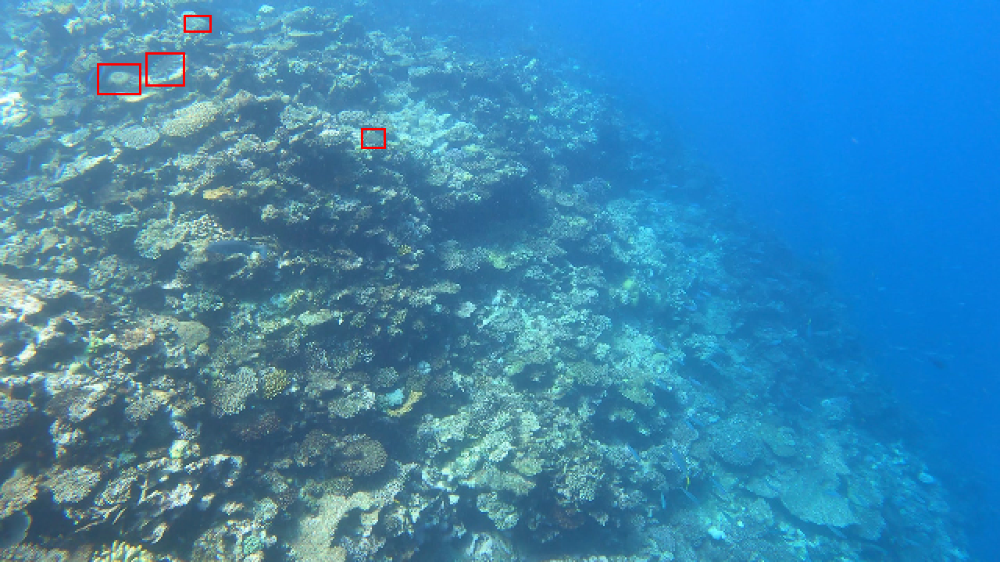

In [36]:
AUGMENTATION = A.Downscale(scale_min=0.5, scale_max=0.5, p=1.0)

def aug_downscale(img):
  img_aug = get_augmented_img(img, AUGMENTATION)
  img_aug = Image.fromarray(img_aug)
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
np_img = np.array(img_selected_display)

for i in range(1):
  aug_downscale(np_img)


## ImageCompression

Decrease Jpeg, WebP compression of an image.

quality_lower: 	float. lower bound on the image quality. Should be in [0, 100] range for jpeg and [1, 100] for webp.

quality_upper:	float. upper bound on the image quality. Should be in [0, 100] range for jpeg and [1, 100] for webp.

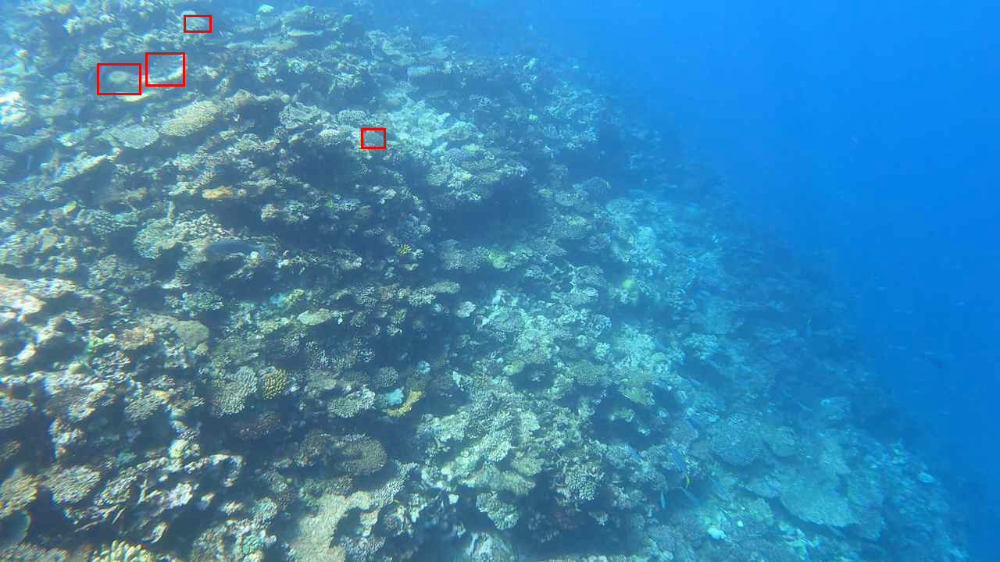

In [37]:
AUGMENTATION = A.ImageCompression(quality_lower=20, quality_upper=40, p = 1.0)

def aug_imgcompression(img):
  img_aug = get_augmented_img(img, AUGMENTATION)
  img_aug = Image.fromarray(img_aug)
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
np_img = np.array(img_selected_display)

for i in range(1):
  aug_imgcompression(np_img)


# Clarity Augmentations

### Sharpen

Sharpens the input image and overlays the result with the original image.

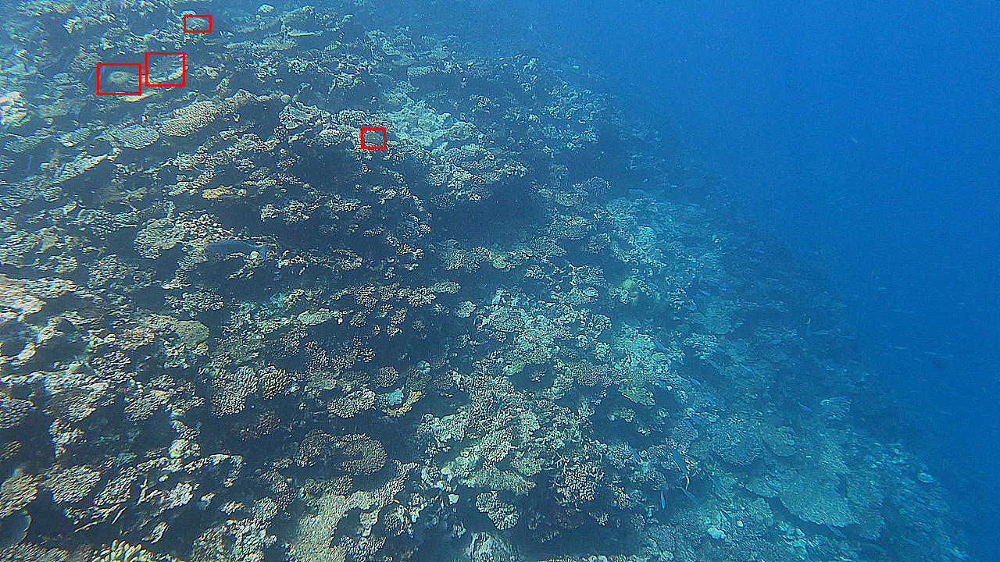

In [38]:
AUGMENTATION = A.Sharpen(p = 1.0)

def aug_shapren(img):
  img_aug = get_augmented_img(img, AUGMENTATION)
  img_aug = Image.fromarray(img_aug)
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
np_img = np.array(img_selected_display)

for i in range(1):
  aug_shapren(np_img)


### CLAHE

Apply Contrast Limited Adaptive Histogram Equalization to the input image.

**Histogram equalization** is another image processing technique to increase global contrast of an image using the image intensity histogram. The equalized image has a linear cumulative distribution function. This method needs no parameter, but it sometimes results an unnatural looking image.

One alternative is **adaptive histogram equalization (AHE)** improves local contrast of an image by computing several histograms corresponding to different sections of an image (differs from ordinary histogram equalization which uses only one histogram to adjust global contrast), 

However, AHE has a tendency to over-amplify noise in relatively homogeneous regions of an image.

Then came CLAHE. Contrast limited adaptive histogram equalization (CLAHE) was developed to prevent the over-amplification of noise resulted from AHE. In gist, it limits the contrast enhancement of AHE by clipping the histogram at a predefined value before computing the cumulative distribution function.

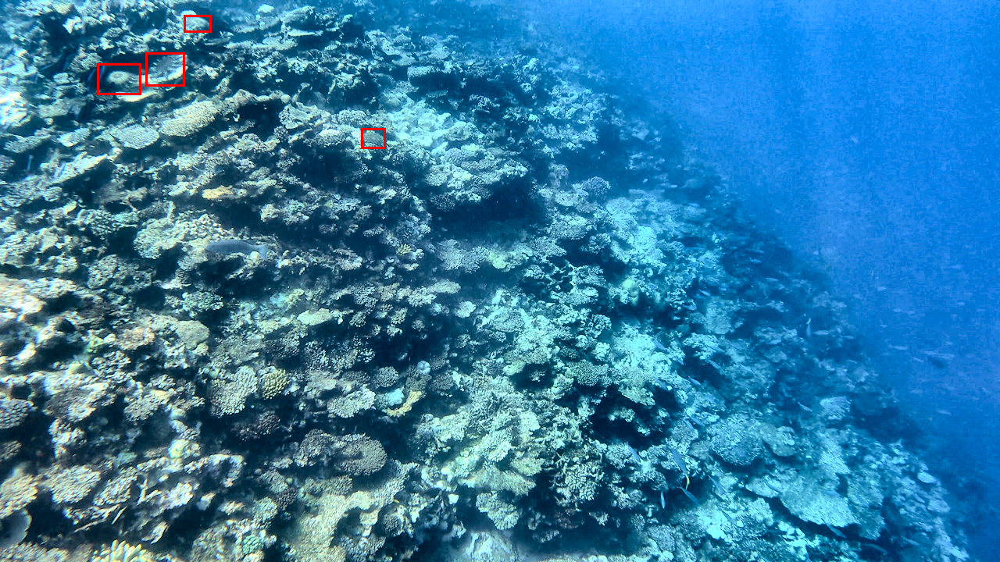

In [39]:
AUGMENTATION = A.CLAHE(p = 1.0)

def aug_clahe(img):
  img_aug = get_augmented_img(img, AUGMENTATION)
  img_aug = Image.fromarray(img_aug)
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
np_img = np.array(img_selected_display)

for i in range(1):
 aug_clahe(np_img)

### Emboss

Emboss the input image and overlays the result with the original image.

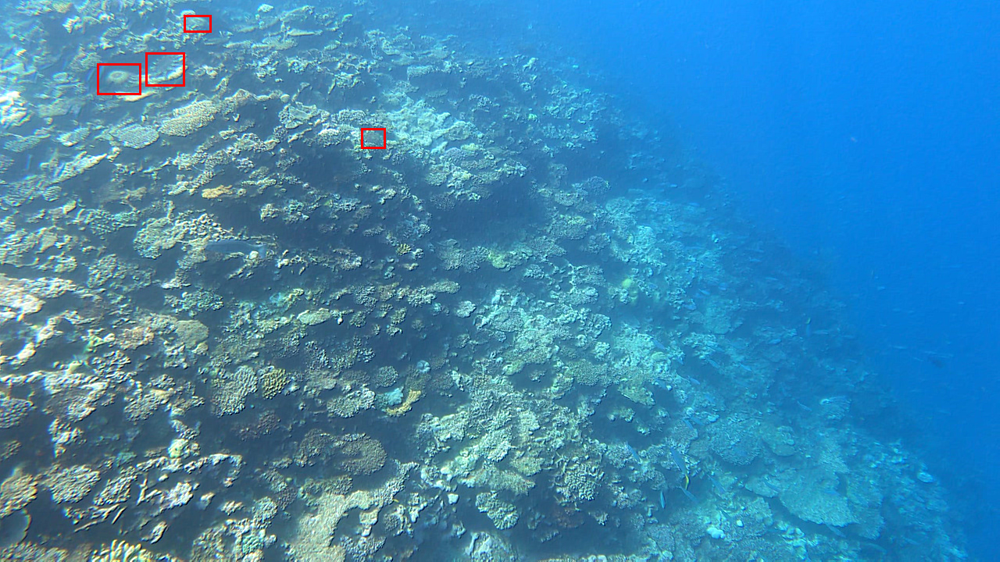

In [40]:
AUGMENTATION = A.Emboss(p = 1.0)

def aug_emboss(img):
  img_aug = get_augmented_img(img, AUGMENTATION)
  img_aug = Image.fromarray(img_aug)
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
np_img = np.array(img_selected_display)

for i in range(1):
 aug_emboss(np_img)


## Color Augmentations

### HueSaturationValue

Randomly change hue, saturation and value of the input image.

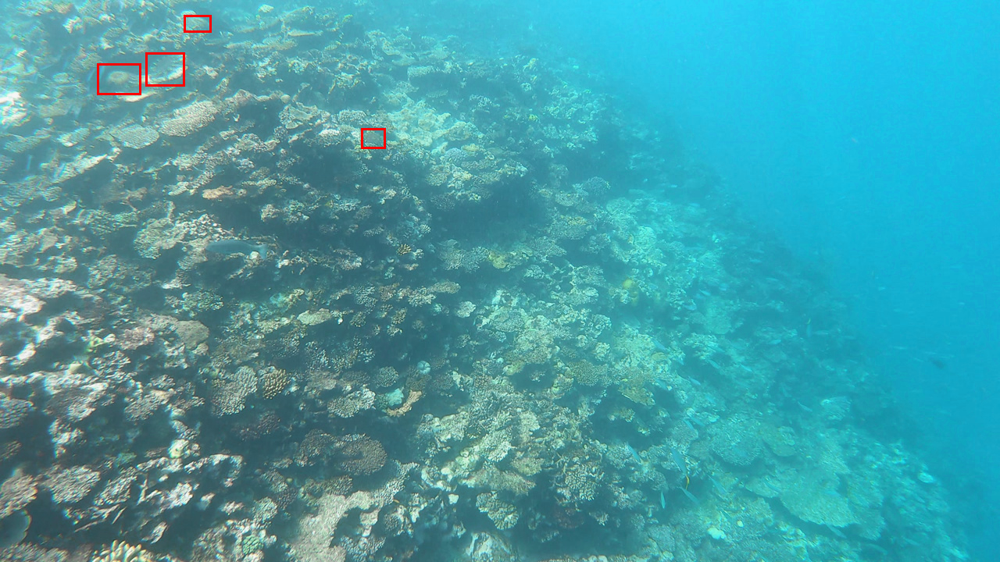

In [41]:
AUGMENTATION = A.HueSaturationValue(p = 2.0)

def aug_huesaturationvalue(img):
  img_aug = get_augmented_img(img, AUGMENTATION)
  img_aug = Image.fromarray(img_aug)
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
np_img = np.array(img_selected_display)

for i in range(1):
  aug_huesaturationvalue(np_img)


### RGBShift

Randomly shift values for each channel of the input RGB image.

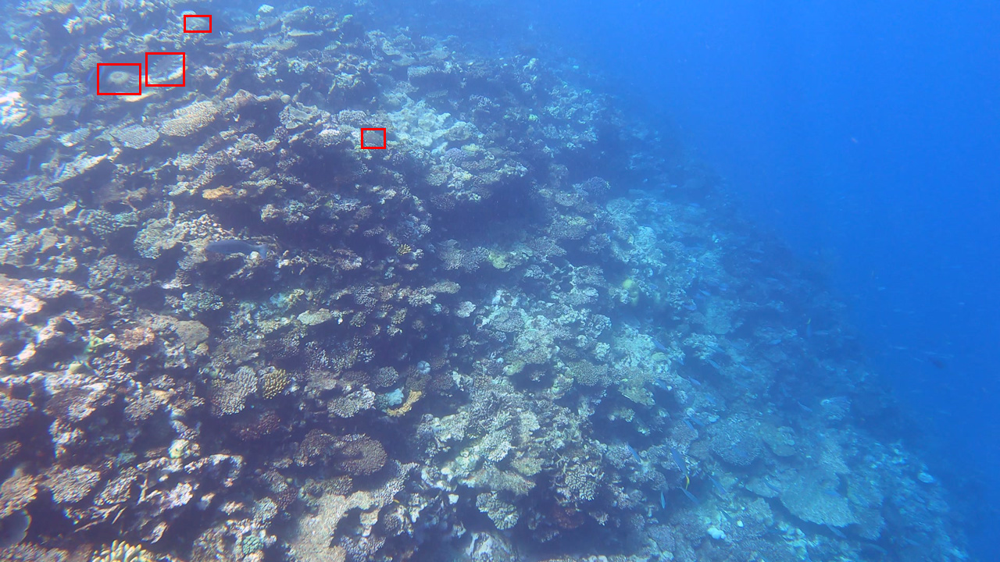

In [42]:
AUGMENTATION = A.RGBShift(p = 1.0)

def aug_rgbshift(img):
  img_aug = get_augmented_img(img, AUGMENTATION)
  img_aug = Image.fromarray(img_aug)
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
np_img = np.array(img_selected_display)

for i in range(1):
  aug_rgbshift(np_img)

### RandomGamma

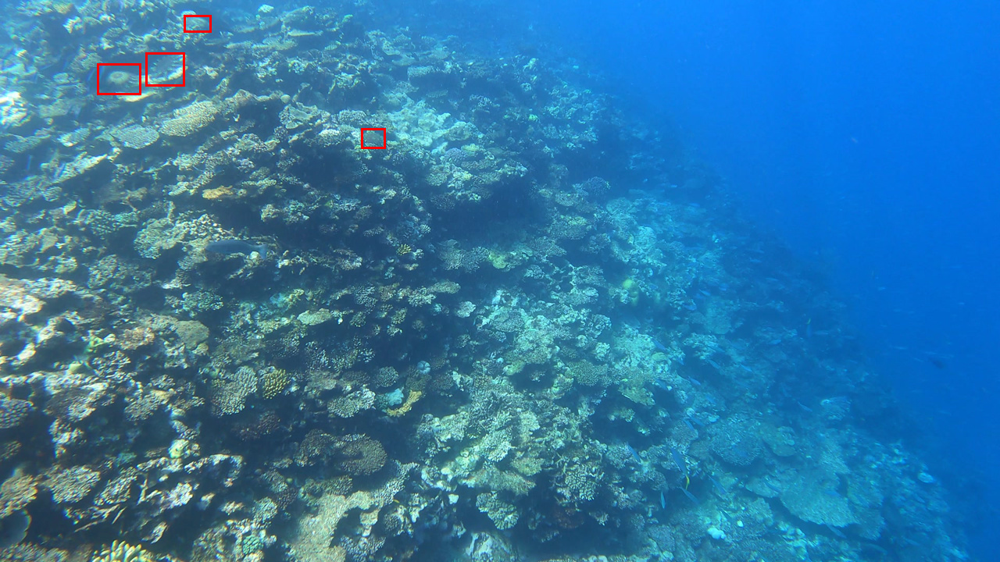

In [43]:
AUGMENTATION = A.RandomGamma(p = 1.0)

def aug_randomgamma(img):
  img_aug = get_augmented_img(img, AUGMENTATION)
  img_aug = Image.fromarray(img_aug)
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
np_img = np.array(img_selected_display)

for i in range(1):
  aug_randomgamma(np_img)

## ElasticTransform

This is one of the Non-rigid transformations provided in Albumentation

Some of the others are GridDistortion, OpticalDistortion.

Specially in medical imaging problems, non-rigid transformations help to augment the data. 


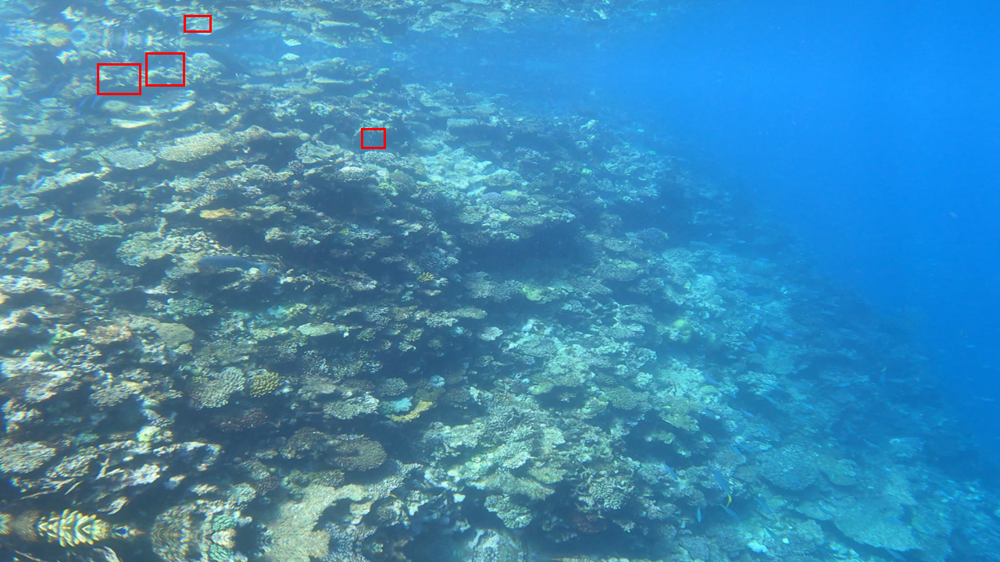

In [44]:
AUGMENTATION = A.ElasticTransform(p=1,border_mode=cv2.BORDER_REFLECT_101,alpha_affine=40)

def aug_randomgamma(img):
  img_aug = get_augmented_img(img, AUGMENTATION)
  img_aug = Image.fromarray(img_aug)
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
np_img = np.array(img_selected_display)

for i in range(1):
  aug_randomgamma(np_img)

## RandomBrightnessContrast

Randomly change brightness and contrast of the input image.

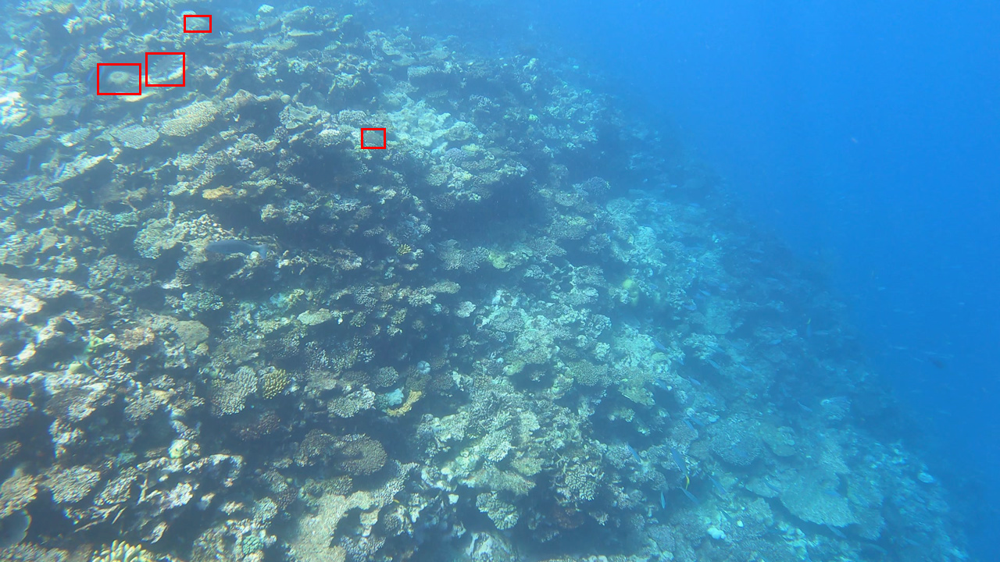

In [45]:
AUGMENTATION = A.RandomBrightnessContrast(p = 1.0)

def aug_randombrightnesscontrast(img):
  img_aug = get_augmented_img(img, AUGMENTATION)
  img_aug = Image.fromarray(img_aug)
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
np_img = np.array(img_selected_display)

for i in range(1):
  aug_randombrightnesscontrast(np_img)

### ChannelShuffle

Randomly rearrange channels of the input RGB image.

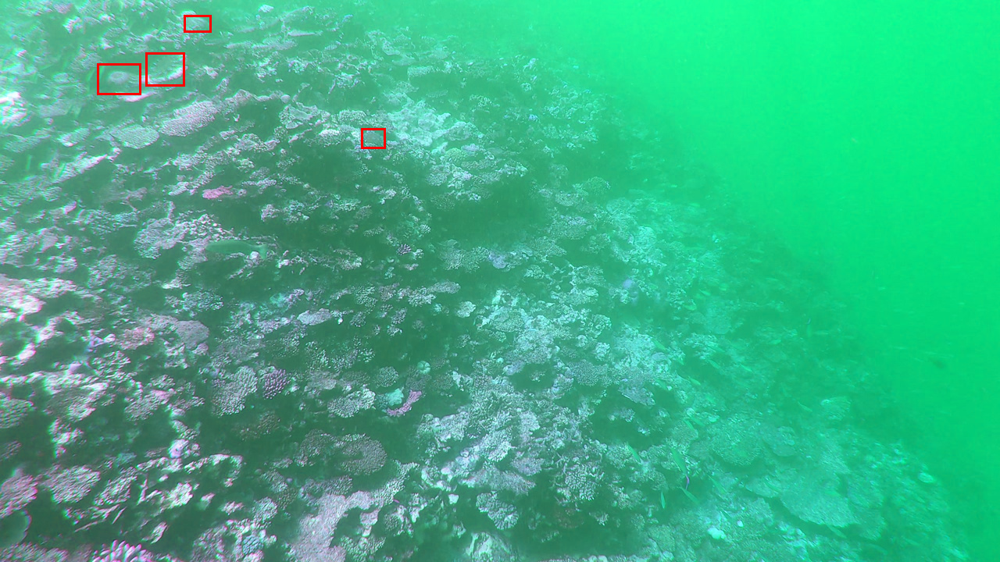

In [46]:
AUGMENTATION = A.ChannelShuffle(p = 1.0)

def aug_channelshuffle(img):
  img_aug = get_augmented_img(img, AUGMENTATION)
  img_aug = Image.fromarray(img_aug)
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
np_img = np.array(img_selected_display)

for i in range(1):
  aug_channelshuffle(np_img)

------------

### Composition of augmentations:

[Source](https://github.com/albumentations-team/albumentations/blob/a5bbfedfc500e9cac1c3689b3720769e4fa727b3/notebooks/example.ipynb)

In [30]:
from albumentations import (
    Sharpen, Emboss, ShiftScaleRotate, CLAHE, ShiftScaleRotate, Blur, OpticalDistortion, GridDistortion, HueSaturationValue,
    GlassBlur, GaussNoise, MotionBlur, MedianBlur,
    RandomContrast, RandomBrightness, Flip, OneOf, Compose
)

def strong_aug(p=1):
    return Compose([        
        OneOf([
            MotionBlur(p=.2),
            MedianBlur(blur_limit=3, p=.1),
            Blur(blur_limit=3, p=.1),
            GaussNoise(p=0.5),
            GlassBlur(p=0.5)
        ], p=0.2),
        ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.2, rotate_limit=45, p=.2),
        OneOf([
            OpticalDistortion(p=0.3),
            GridDistortion(p=.1),
            HueSaturationValue(p=0.3)
        ], p=0.2),
        OneOf([
            CLAHE(clip_limit=2),
            Sharpen(),
            Emboss(),
            RandomContrast(),
            RandomBrightness(),
        ], p=0.3),
        #HueSaturationValue(p=0.3),
    ], p=p)  


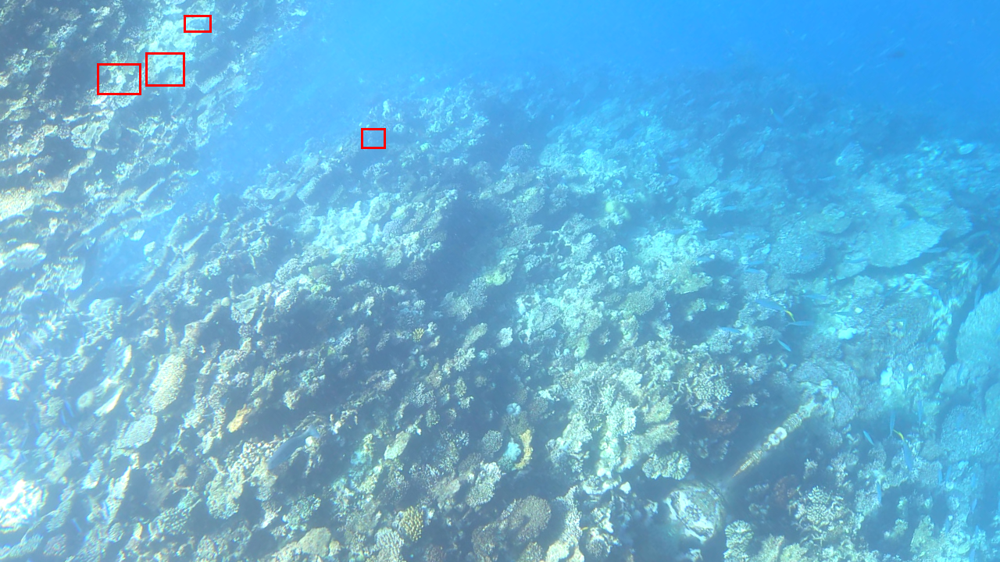

In [48]:

AUGMENTATION = strong_aug(p=1)

def aug_composite(img):
  img_aug = get_augmented_img(img, AUGMENTATION)
  img_aug = Image.fromarray(img_aug)
  img_after_augment = get_img_with_rectangle(img_aug, id=2635)
  display(img_after_augment)
  
np_img = np.array(img_selected_display)

for i in range(1):
  aug_composite(np_img)